In [1]:
pip install shap

Note: you may need to restart the kernel to use updated packages.


In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
from matplotlib import pyplot as plt
from sklearn.preprocessing import StandardScaler,OneHotEncoder
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
import xgboost as xgb
import lightgbm as lgb
from catboost import CatBoostRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.model_selection import KFold
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import Ridge,ElasticNet,Lasso
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.base import BaseEstimator, TransformerMixin, RegressorMixin, clone
from sklearn.manifold import TSNE
import catboost
import shap
from scipy.stats import shapiro
from sklearn.preprocessing import LabelEncoder, power_transform
from scipy import stats
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

        
#I was inspired by https://www.kaggle.com/serigne/stacked-regressions-top-4-on-leaderboard?select=test.csv
# and https://www.kaggle.com/allunia/house-prices-tutorial-with-catboost . Thank you!
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/house-prices-advanced-regression-techniques/data_description.txt
/kaggle/input/house-prices-advanced-regression-techniques/sample_submission.csv
/kaggle/input/house-prices-advanced-regression-techniques/test.csv
/kaggle/input/house-prices-advanced-regression-techniques/train.csv


In [3]:
data_train = pd.read_csv('/kaggle/input/house-prices-advanced-regression-techniques/train.csv')
data_test = pd.read_csv("/kaggle/input/house-prices-advanced-regression-techniques/test.csv")
data_test = data_test.drop(['Id'],1)
data = data_train.append(data_test)
data = data.drop(['SalePrice'],1)
data = data.drop(['Id'],1)


# Target Variable Exploration
There are a lot of different approaches for target variable exploration. Plotting distribution, correlations and dependencies with other features are the most common and really make sence for firtst steps.

The Distribution Of data looks close to Normal but with heavy tail. Lets check the normality with the helo of Shapiro-Wilk test. This test is the most reliable among others and can produce appropriate results on even datasets of 10 elements.

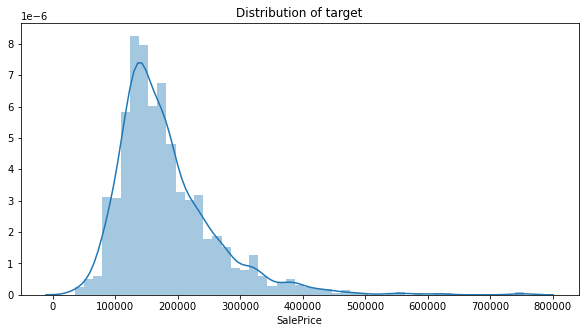

In [4]:
target = data_train.SalePrice
plt.figure(figsize=(10,5))
sns.distplot(target);
plt.title('Distribution of target');

The test produced p-value much less than 0.05, that's why hypotesis that data distributed not normally is rejected. Anyway, the drawback of hypotesis testing methods at all is, that they usually do not reject a Null Hypotesis on big datasets. 

In [5]:
print("p-value for shapiro-wilk test is ",shapiro(target)[1] )

p-value for shapiro-wilk test is  3.206247534576162e-33


# Correlation
Correlation is a score that shows linear relationship between variables. As we can see, there are some features that are correlated very high

In [6]:
corr_cols = ['OverallQual', 'GrLivArea', 'GarageCars', 'TotalBsmtSF', 
             'FullBath', 'YearBuilt']

print("Correlations")
for i in corr_cols:
    print(i,"and target",np.corrcoef(target,data_train[i])[0][1])
    

Correlations
OverallQual and target 0.7909816005838048
GrLivArea and target 0.7086244776126522
GarageCars and target 0.6404091972583531
TotalBsmtSF and target 0.6135805515591956
FullBath and target 0.5606637627484456
YearBuilt and target 0.5228973328794969


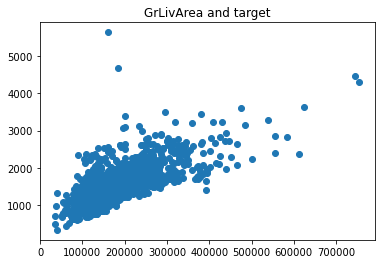

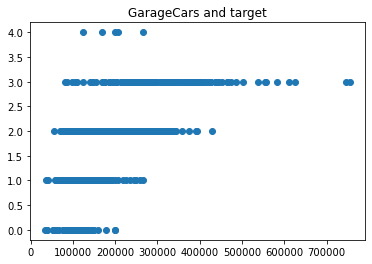

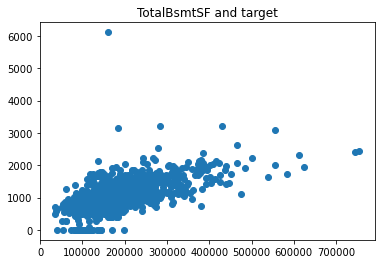

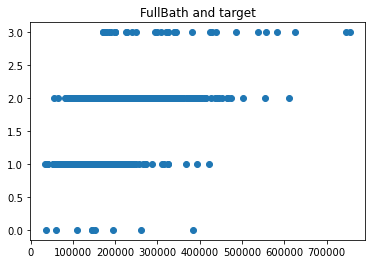

In [7]:
for i in ['GrLivArea', 'GarageCars', 'TotalBsmtSF', 
             'FullBath']:
    plt.scatter(target,data_train[i])
    plt.title(i + " and target")
    plt.show()

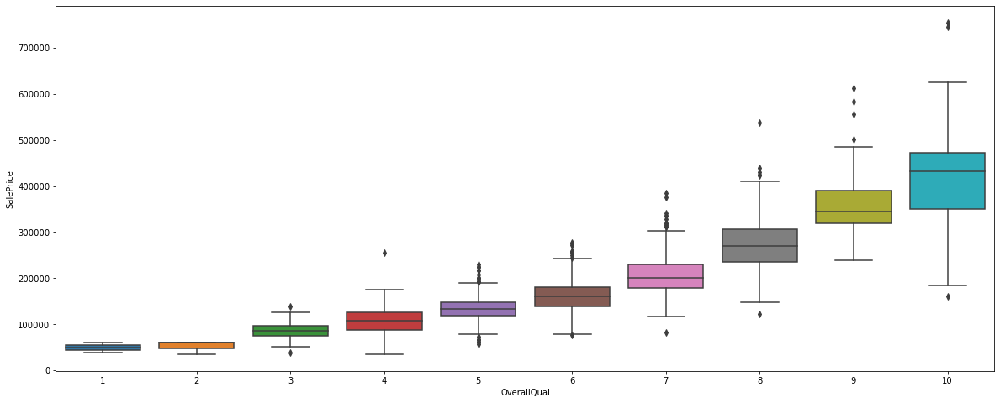

In [8]:
plt.figure(figsize=(20,8))
sns.boxplot(x='OverallQual',y='SalePrice',data=data_train);

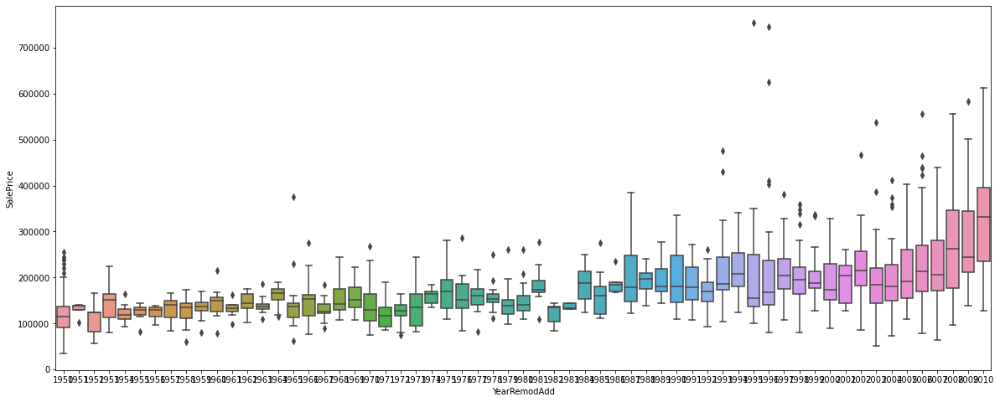

In [9]:
plt.figure(figsize=(20,8))
sns.boxplot(x='YearRemodAdd',y='SalePrice',data=data_train);

# NA's Processing and Feature Engineering
Speaking about Feature Engineering it is important to mention, that Data Description cal help to solve this issue quite fast. Because this is a dataset about houses some "NAs" can be replaces with "None" or mode. Not all houses have the same options and advantages.

In [10]:
nas_ratio =  data.isnull().sum() / data.shape[0]  * 100
nas_ratio = nas_ratio.drop(nas_ratio[nas_ratio==0].index).sort_values(ascending=False)
nas_ratio

PoolQC          99.657417
MiscFeature     96.402878
Alley           93.216855
Fence           80.438506
FireplaceQu     48.646797
LotFrontage     16.649538
GarageFinish     5.447071
GarageYrBlt      5.447071
GarageQual       5.447071
GarageCond       5.447071
GarageType       5.378554
BsmtExposure     2.809181
BsmtCond         2.809181
BsmtQual         2.774923
BsmtFinType2     2.740665
BsmtFinType1     2.706406
MasVnrType       0.822199
MasVnrArea       0.787941
MSZoning         0.137033
BsmtFullBath     0.068517
BsmtHalfBath     0.068517
Utilities        0.068517
Functional       0.068517
Exterior2nd      0.034258
Exterior1st      0.034258
SaleType         0.034258
BsmtFinSF1       0.034258
BsmtFinSF2       0.034258
BsmtUnfSF        0.034258
Electrical       0.034258
KitchenQual      0.034258
GarageCars       0.034258
GarageArea       0.034258
TotalBsmtSF      0.034258
dtype: float64

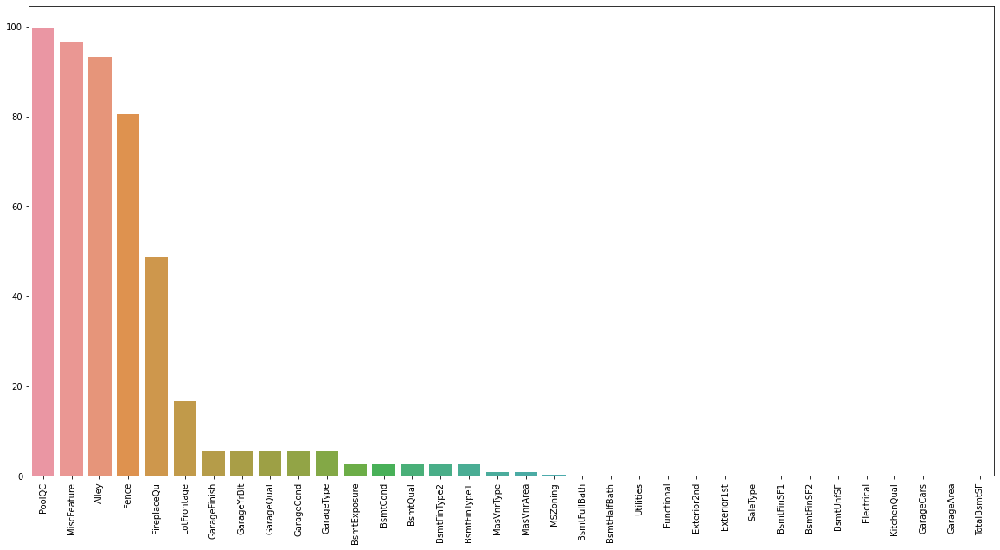

In [11]:
plt.figure(figsize=(20,10))
plt.xticks(rotation='90')
sns.barplot(x=nas_ratio.index,y=nas_ratio);

## Imputing 'None' values according to data description

In [12]:

data["PoolQC"] = data["PoolQC"].fillna("None")
data["MiscFeature"] = data["MiscFeature"].fillna("None")
data["Alley"] = data["Alley"].fillna("None")
data["Fence"] = data["Fence"].fillna("None")
data["FireplaceQu"] = data["FireplaceQu"].fillna("None")
for col in ('GarageType', 'GarageFinish', 'GarageQual', 'GarageCond'):
    data[col] = data[col].fillna('None')
for col in ('GarageYrBlt', 'GarageArea', 'GarageCars'):
    data[col] = data[col].fillna(0)
for col in ('BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF','TotalBsmtSF', 'BsmtFullBath', 'BsmtHalfBath'):
    data[col] = data[col].fillna(0)
for col in ('BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2'):
    data[col] = data[col].fillna('None')
data["MasVnrType"] = data["MasVnrType"].fillna("None")
data["MasVnrArea"] = data["MasVnrArea"].fillna(0)
data["Functional"] = data["Functional"].fillna("Typ")
data['Electrical'] = data['Electrical'].fillna(data['Electrical'].mode()[0])
data['KitchenQual'] = data['KitchenQual'].fillna(data['KitchenQual'].mode()[0])
data['Exterior1st'] = data['Exterior1st'].fillna(data['Exterior1st'].mode()[0])
data['Exterior2nd'] = data['Exterior2nd'].fillna(data['Exterior2nd'].mode()[0])
data['SaleType'] = data['SaleType'].fillna(data['SaleType'].mode()[0])
data['MSSubClass'] = data['MSSubClass'].fillna("None")
data["LotFrontage"] = data.groupby("Neighborhood")["LotFrontage"].transform(
    lambda x: x.fillna(x.median()))
data['MSZoning'] = data['MSZoning'].fillna(data['MSZoning'].mode()[0])


data = data.drop(['Utilities'], axis=1)
data = data.drop(['Street'], axis=1)
data = data.drop(['Condition2'], axis=1)
data = data.drop(['RoofMatl'], axis=1)
data = data.drop(['PoolArea'], axis=1)
data = data.drop(['3SsnPorch'], axis=1)
data = data.drop(['LandSlope'], axis=1)
data = data.drop(['LowQualFinSF'], axis=1)
data = data.drop(['Electrical'], axis=1)
data = data.drop(['MiscFeature'], axis=1)

label_enc = LabelEncoder()
data["YearBuilt"] = label_enc.fit_transform(data["YearBuilt"])
data["YearRemodAdd"] = label_enc.fit_transform(data["YearRemodAdd"])
data["GarageYrBlt"] = label_enc.fit_transform(data["GarageYrBlt"])
data['MoSold'] = label_enc.fit_transform(data['MoSold'])
data['OverallCond'] = label_enc.fit_transform(data['OverallCond'])
data['MSSubClass'] = label_enc.fit_transform(data['MSSubClass'])
data['YrSold'] = label_enc.fit_transform(data['YrSold'])



data['TotalSF'] = data['TotalBsmtSF'] + data['1stFlrSF'] + data['2ndFlrSF']

print("Now there are",data.isnull().sum().sum(),"NA values now")

Now there are 0 NA values now


# Remove Skew Data
"LotArea" is a high-skew numeric feature. With the help of "Box-Cox" lets remove skewness. Other variables are not appropriate for this method

In [13]:
print(data.skew().sort_values(ascending=False).head(10))

data["LotArea"], _ = stats.boxcox(data["LotArea"].values)
print("skew after:",data["LotArea"].skew())

MiscVal          21.958480
LotArea          12.829025
KitchenAbvGr      4.304467
BsmtFinSF2        4.148275
EnclosedPorch     4.005950
ScreenPorch       3.948723
BsmtHalfBath      3.933616
MasVnrArea        2.614936
OpenPorchSF       2.536417
WoodDeckSF        1.843380
dtype: float64
skew after: 0.10352885791348848


In [14]:
to_std = ['LotFrontage', 'LotArea',
         'YearBuilt','YearRemodAdd',
         'MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF',
         '1stFlrSF','BsmtFullBath','GarageYrBlt','GarageArea',
         'WoodDeckSF','MoSold','YrSold','TotalSF']

for i in range(len(to_std)):
    data[to_std[i]] = data[to_std[i]].astype("float64")

In [15]:
for c in to_std:
    std = StandardScaler()
    std.fit(list(np.array(data[c]).reshape(-1,1))) 
    data[c] = std.transform(list(np.array(data[c]).reshape(-1,1)))

 # Dummies

In [16]:
data = pd.get_dummies(data)

# Modelling

In [17]:
X = data[:1460].values
y = data_train.SalePrice.values

In [18]:
test = data[1460:]

In [19]:
n_folds = 5

def rmsle_cv(model):
    kf = KFold(n_folds, shuffle=True).get_n_splits(X)
    rmse= np.sqrt(-cross_val_score(model, X, y, scoring="neg_mean_squared_error", cv = kf))
    return(rmse.mean())


In [20]:
model_xgb = xgb.XGBRegressor(colsample_bytree=0.46, gamma=0.047, 
                             learning_rate=0.05, max_depth=3, 
                             min_child_weight=1.785, n_estimators=2200,
                             reg_alpha=0.465, reg_lambda=0.86,
                             subsample=0.522)
print("xgb: ",rmsle_cv(model_xgb))

xgb:  25152.298595331184


In [21]:
model_lgb = lgb.LGBMRegressor(objective='regression',num_leaves=5,
                              learning_rate=0.05, n_estimators=720,
                             max_bin = 55, bagging_fraction = 0.82,
                             bagging_freq = 5, feature_fraction = 0.232,
                             feature_fraction_seed=9, bagging_seed=9,
                              min_data_in_leaf =6, min_sum_hessian_in_leaf = 11)
print("lgb:",rmsle_cv(model_lgb))

lgb: 26528.26785569669


In [22]:
cat_boost = CatBoostRegressor(learning_rate=0.05,
                            n_estimators=800,depth=3,silent=True)
print("catboost: ",rmsle_cv(cat_boost))

catboost:  26286.039472672313


In [23]:
Enet = ElasticNet(alpha=0.005,
                 l1_ratio=0.85,max_iter=15000)
print("enet: ", rmsle_cv(Enet))

enet:  32393.08600756814


# Averaging Models

In [24]:
class AveragingModels(BaseEstimator, RegressorMixin, TransformerMixin):
    def __init__(self, models):
        self.models = models
        
    # we define clones of the original models to fit the data in
    def fit(self, X, y):
        self.models_ = [clone(x) for x in self.models]
        
        # Train cloned base models
        for model in self.models_:
            model.fit(X, y)

        return self
    
    #Now we do the predictions for cloned models and average them
    def predict(self, X):
        predictions = np.column_stack([
            model.predict(X) for model in self.models_
        ])
        return np.mean(predictions, axis=1)   

In [25]:
models_forAverage = AveragingModels(models=(cat_boost,model_xgb,model_lgb))
print(rmsle_cv(models_forAverage))

25203.556013010915


# T-SNE. Visualization
T-SNE is a very powerful unsupervised visualization algorithm. It looks at the relationship between object in multi-dimensional space and tryes to interpret them into new dimension.

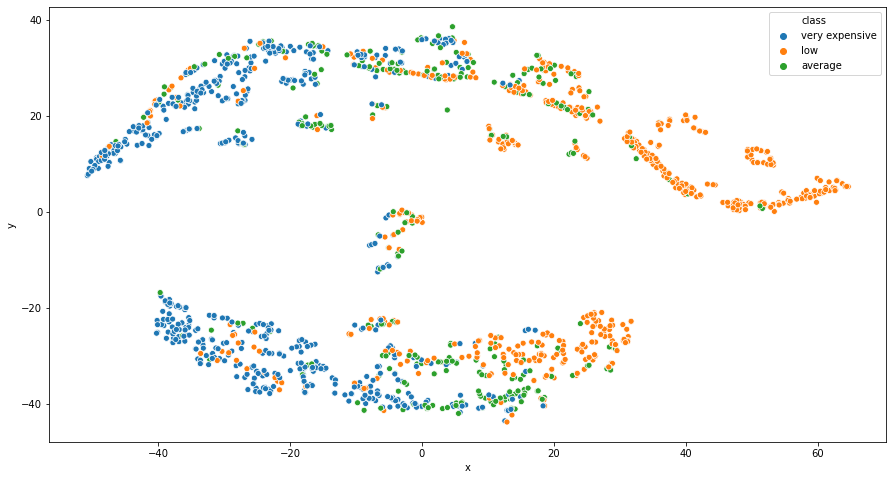

In [26]:
perc_60 = np.percentile(y,60)
perc_40 = np.percentile(y,40)


tsne = TSNE().fit_transform(data[:1460])
tsne_data = pd.DataFrame(columns=['x','y'])
tsne_data['x'] = tsne[:,0]
tsne_data['y'] = tsne[:,1]
tsne_data['class'] = np.where(y>perc_60,'very expensive',
                             (np.where(y>perc_40, 'average','low')))
plt.figure(figsize=(15,8))
sns.scatterplot(data=tsne_data,x='x',y='y',hue='class');

 # CatBoost's Feature Selection

Cat boost provides essential tools for feature selection and interaction visualization. With the help of plots we can decide which feature interacts with others better and which one helps to improve the perfomance of model more then others. By using feature selection, I tuned "border count" parametr. This parameter plays with "Golden Features" in the way to use them smarter. Therefore, it really increased perfomance!

In [27]:
cat_bst = CatBoostRegressor(iterations=1000,learning_rate=0.1,silent=True)
cat_bst.fit(X,y)

In [28]:
shap.initjs()
shap_values = cat_bst.get_feature_importance(catboost.Pool(X,y),type="ShapValues")

expected = shap_values[0,-1]
shap_val = shap_values[:,:-1]

shap.force_plot(expected,shap_val[0,:],data[:1460].iloc[0,:])

In [29]:
shap.force_plot(expected,shap_val,X)

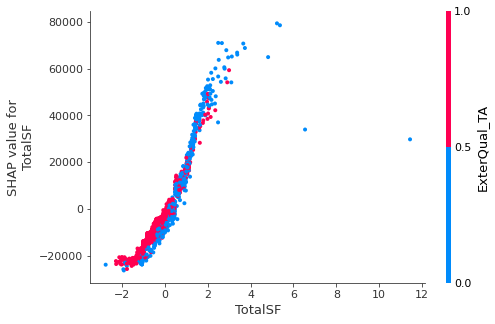

In [30]:
shap.dependence_plot("TotalSF",shap_val,data[:1460])

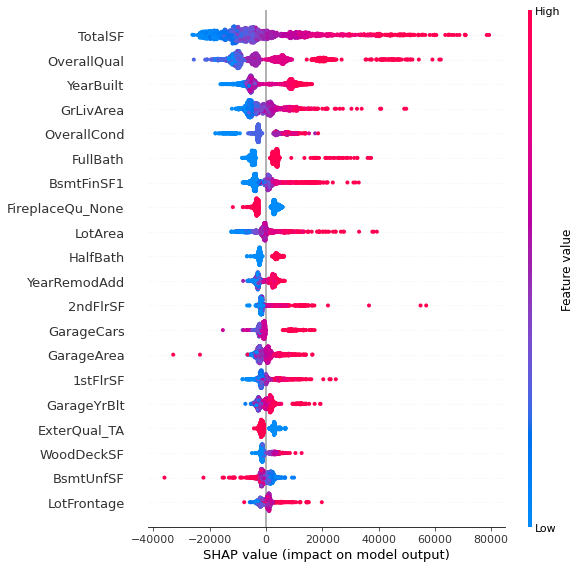

In [31]:
shap.summary_plot(shap_val,data[:1460])

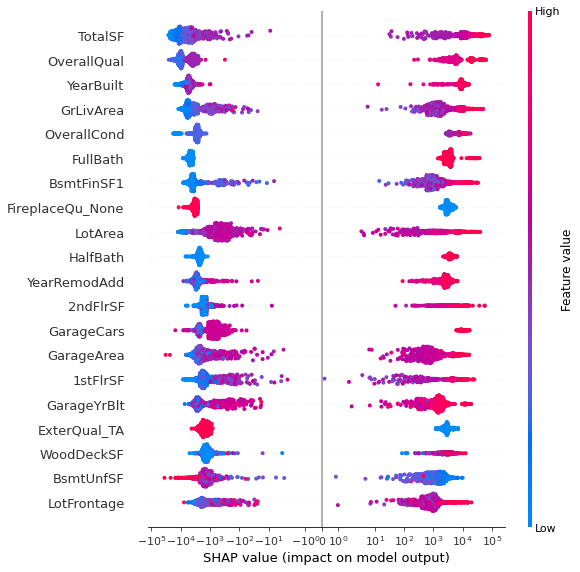

In [32]:
shap.summary_plot(shap_val,data[:1460],use_log_scale=True)

In [33]:
feature_interactions = cat_bst.get_feature_importance(catboost.Pool(X,y),type="Interaction")

In [34]:
fi_new = []
for k, item in enumerate(feature_interactions):
    first = data.dtypes.index[feature_interactions[k][0]]
    second = data.dtypes.index[feature_interactions[k][1]]
    if first != second:
        fi_new.append([first+ " " + second, feature_interactions[k][2]])

Indexing with a float is deprecated, and will raise an IndexError in pandas 2.0. You can manually convert to an integer key instead.
Indexing with a float is deprecated, and will raise an IndexError in pandas 2.0. You can manually convert to an integer key instead.


In [35]:
fi_new[:10]

[['OverallQual TotalSF', 1.7028909074835124],
 ['OverallQual GarageCars', 0.7398205670720024],
 ['GrLivArea Neighborhood_Edwards', 0.6647373436358627],
 ['GrLivArea TotalSF', 0.6427156712305434],
 ['YearBuilt TotalSF', 0.6198819259676503],
 ['TotalSF Neighborhood_Edwards', 0.5994408621760641],
 ['OverallQual GarageArea', 0.5382018690683911],
 ['TotalSF GarageType_2Types', 0.5250505498443462],
 ['LotArea TotalSF', 0.4917994575889399],
 ['1stFlrSF GarageArea', 0.4853825296540335]]

In [36]:
interaction_score = pd.DataFrame(fi_new,columns=['Feature-Pair','Interaction Score'])
interaction_score = interaction_score.sort_values(by="Interaction Score",ascending=False,
                                                 inplace=False,na_position='last')

In [37]:
interaction_score[:20]

,Feature-Pair,Interaction Score
0,OverallQual TotalSF,1.702891
1,OverallQual GarageCars,0.739821
2,GrLivArea Neighborhood_Edwards,0.664737
3,GrLivArea TotalSF,0.642716
4,YearBuilt TotalSF,0.619882
5,TotalSF Neighborhood_Edwards,0.599441
6,OverallQual GarageArea,0.538202
7,TotalSF GarageType_2Types,0.525051
8,LotArea TotalSF,0.491799
9,1stFlrSF GarageArea,0.485383


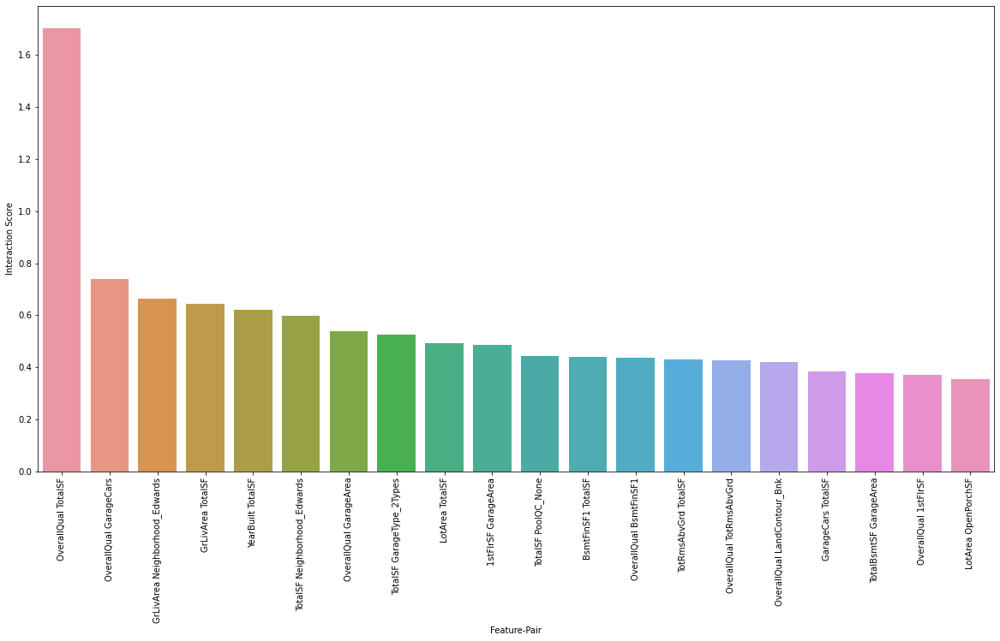

In [38]:
plt.figure(figsize=(20,10))
sns.barplot(data = interaction_score[:20], x = 'Feature-Pair', 
           y = 'Interaction Score')
plt.xticks(rotation=90);

In [39]:
extended_catboost = CatBoostRegressor(per_float_feature_quantization=['3:border_count=1024', '33:border_count=1024'],
                                     depth=8,
                                     learning_rate=0.025,
                                     n_estimators=2000,silent=True)
print(rmsle_cv(extended_catboost))

25913.001587783012


In [40]:
models_forAverage2 = AveragingModels(models=(extended_catboost,model_xgb))
print(rmsle_cv(models_forAverage2))

24911.031907832737


In [41]:
data_test = pd.read_csv("/kaggle/input/house-prices-advanced-regression-techniques/test.csv")
IDS = data_test['Id']

# To avoid Models Conflicts

In [42]:
model_xgb2 = xgb.XGBRegressor(colsample_bytree=0.46, gamma=0.047, 
                             learning_rate=0.05, max_depth=3, 
                             min_child_weight=1.785, n_estimators=2200,
                             reg_alpha=0.465, reg_lambda=0.86,
                             subsample=0.522)
model_xgb2.fit(data[:1460],y)

extended_catboost2 = CatBoostRegressor(per_float_feature_quantization=['3:border_count=1024', '33:border_count=1024'],
                                     depth=8,
                                     learning_rate=0.025,
                                     n_estimators=2000,silent=True)
extended_catboost2.fit(data[:1460],y)



In [43]:
sub = pd.DataFrame()
sub['Id'] = IDS
sub['SalePrice'] = (model_xgb2.predict(data[1460:])*0.5) + (extended_catboost2.predict(data[1460:])*0.5)
sub.to_csv('submission.csv',index=False)